In [2]:
from PIL import Image, ImageDraw
import shapely.geometry
from shapely.geometry import Polygon
import numpy as np
import folium
import json
import geojson
import os
import base64
from IPython.display import IFrame

import matplotlib.pyplot as plt

In [26]:
# path_to_image = "train/images/guatemala-volcano_00000000_post_disaster.png"
# path_to_damage = "train/targets/guatemala-volcano_00000000_post_disaster_target.png"
# path_to_labels = "train/labels/guatemala-volcano_00000000_post_disaster.json"
# path_to_output = "aa.png"
path_to_geotransforms = "train/xview_geotransforms.json"

# image = Image.open(path_to_image)

# damage = Image.open(path_to_damage)
# dmg_arr = np.array(damage)

# with open(path_to_labels) as f:
#     labels = geojson.load(f)

with open(path_to_geotransforms) as f:
    geotransforms = json.load(f)

In [45]:
def add_polygons_and_photo_to_map(map, labels, paths_to_imgs, path_to_image):
    for i, (label, label_img_draw_data) in enumerate(zip(labels['features']['lng_lat'], labels['features']['xy'])):
        points = []
        points_img = []
        subtype = label['properties'].get('subtype', "before event")
        if subtype=='no-damage':
            color='g'
        elif subtype=='minor-damage':
            color='y'
        elif subtype=='destroyed':
            color='red'
        else:
            color = 'b'

        feature_type = label['properties']['feature_type']

        polygon_pts = label['wkt'][10:-2]
        for pt in polygon_pts.split(", "):
            points.append((float(pt.split(" ")[1]), float(pt.split(" ")[0])))
        folium.Polygon(points).add_to(map)

        polygon_pts = label_img_draw_data['wkt'][10:-2]
        for pt in polygon_pts.split(", "):
            points_img.append((float(pt.split(" ")[1]), float(pt.split(" ")[0])))
        polygon = shapely.geometry.Polygon(points_img)

        x,y = polygon.exterior.coords.xy
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(Image.open(paths_to_imgs+path_to_image))
        ax.plot(y,x, color=color, linewidth=6)
        ax.axis('off')
        fig.suptitle(f"{feature_type}: {subtype}", fontsize=40)
        fig.savefig(f"tmp/{path_to_image.replace('.png', '')}_tmp{i}.png")
        plt.close(fig)
        

        encoded = base64.b64encode(open(f"tmp/{path_to_image.replace('.png', '')}_tmp{i}.png", 'rb').read()).decode('UTF-8')
        html = f'''
        <div><img src="data:image/png;base64,{encoded}" width="400" height="400"></div>
        '''


        popup = folium.Popup(html)
        folium.Marker(points[0], popup=popup).add_to(map)


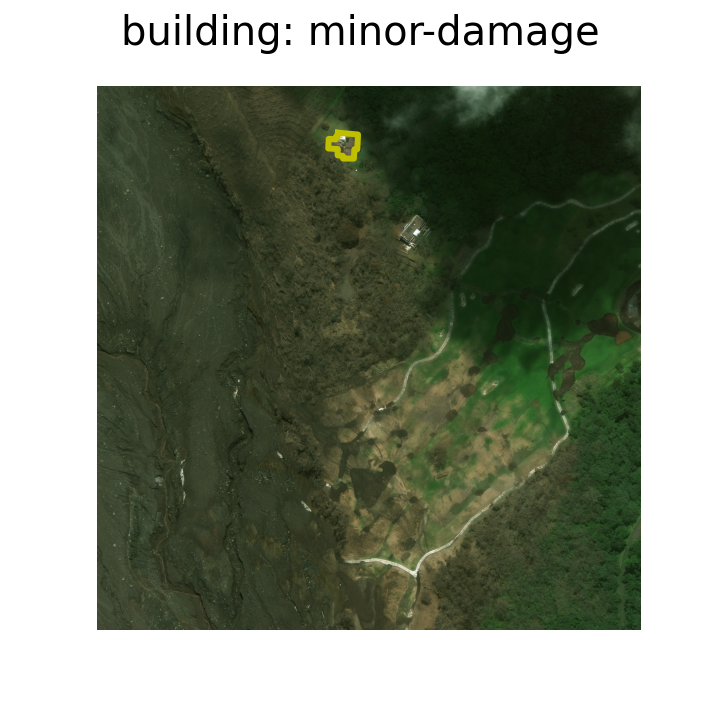
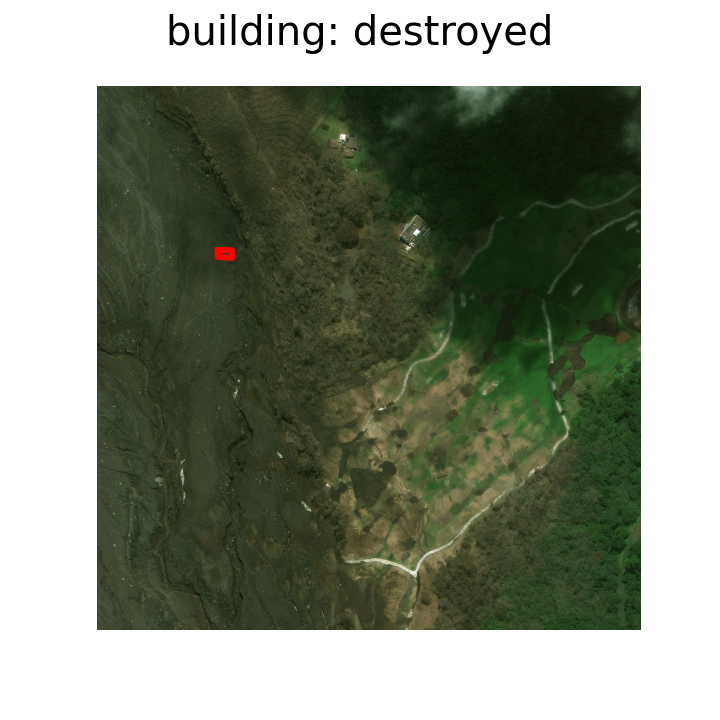
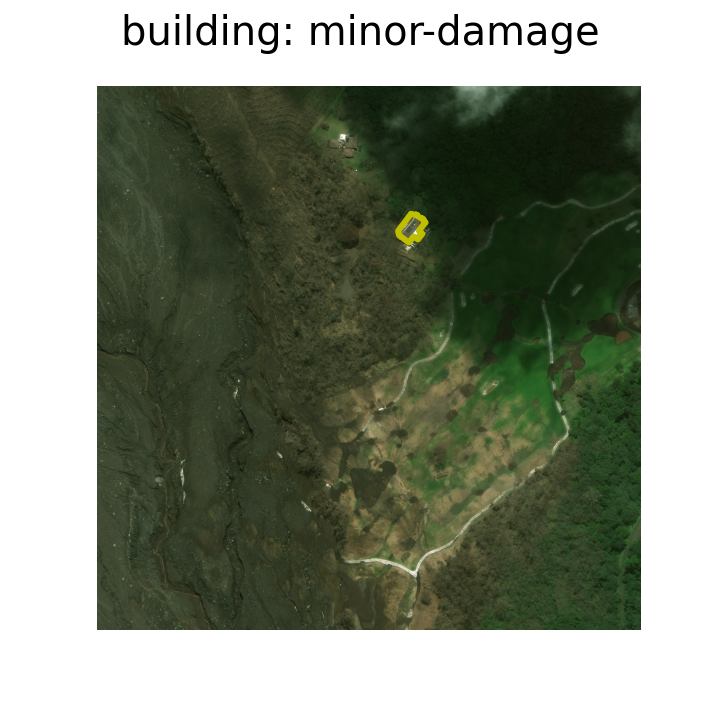
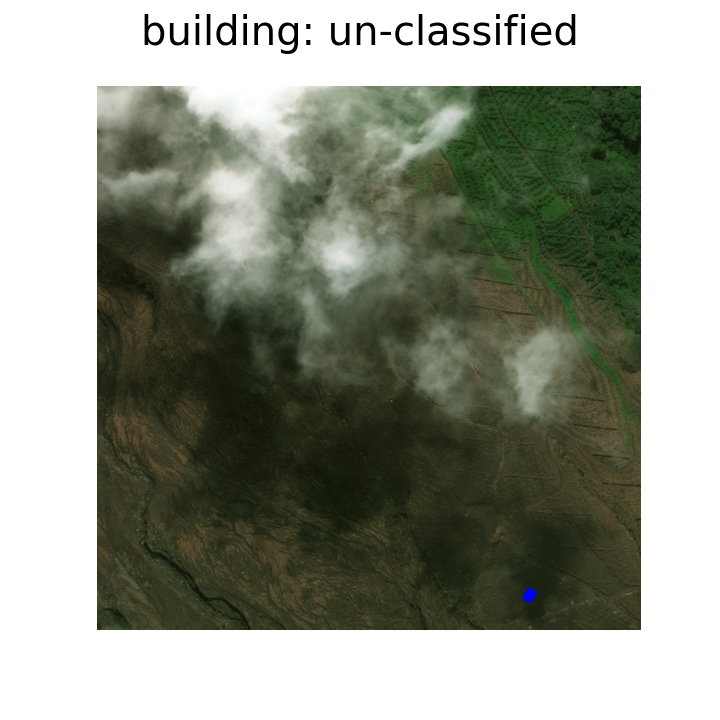
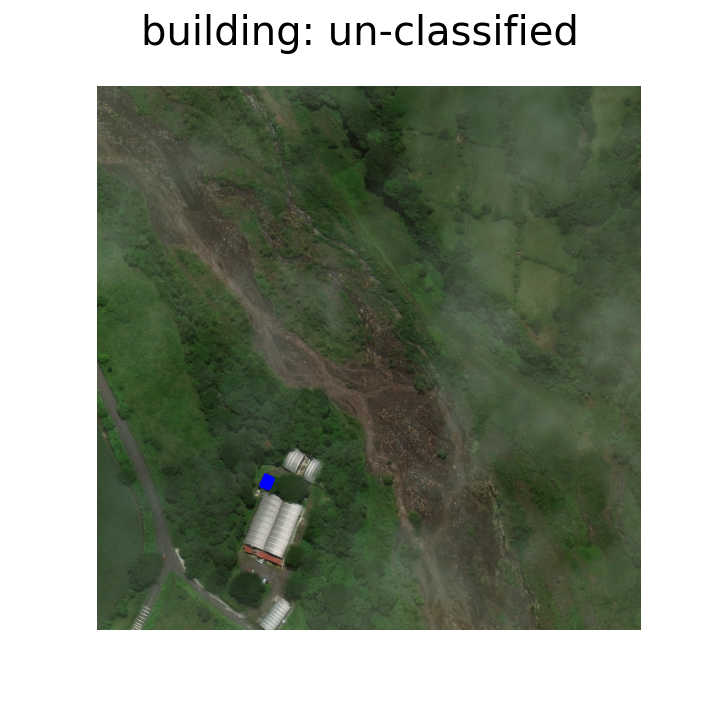
...
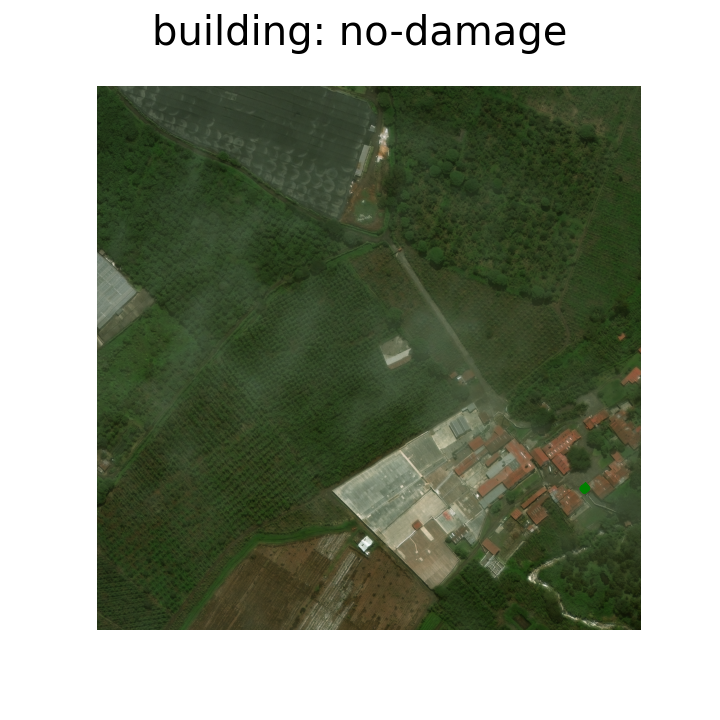
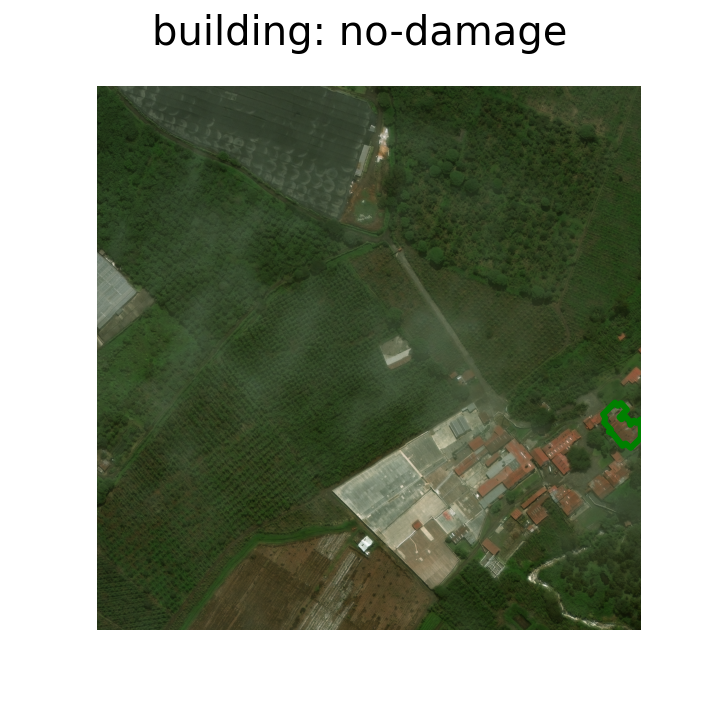
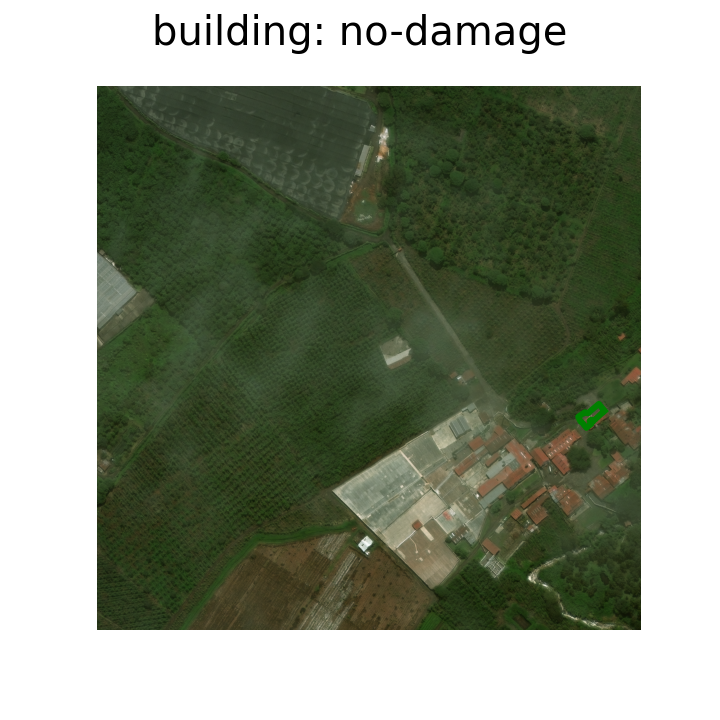
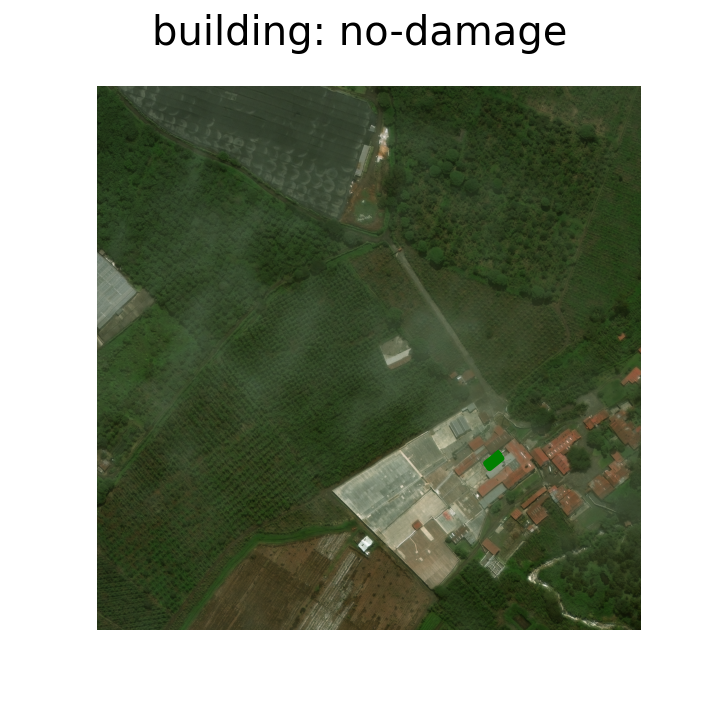
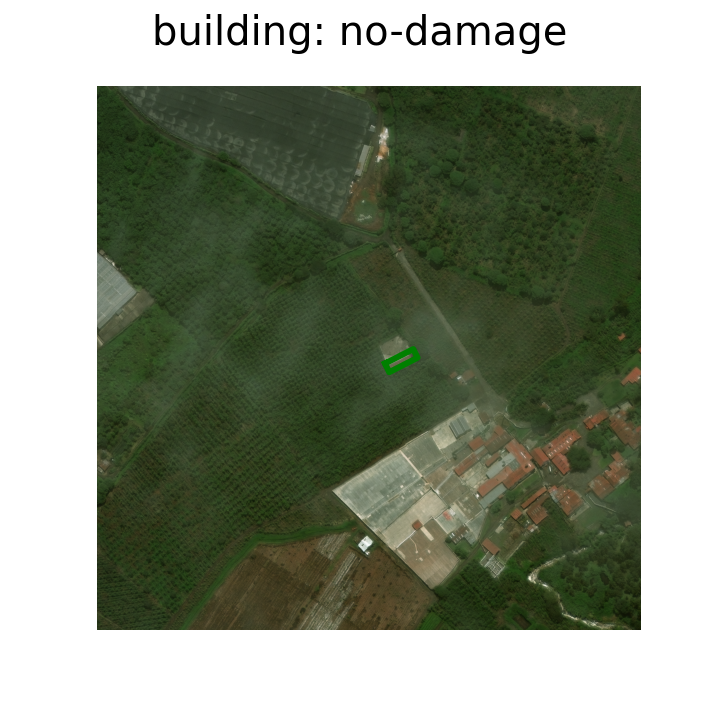

In [46]:
paths_to_labels = "train/labels/"
paths_to_imgs = "train/images/"

labels_path = os.listdir(paths_to_labels)
labels_path.sort()

imgs_path = os.listdir(paths_to_imgs)
imgs_path.sort()

center = [geotransforms[imgs_path[0]][0][3], geotransforms[imgs_path[0]][0][0]]
m = folium.Map(center, zoom_start=15)

for i in range(10):
    if "pre_disaster" in labels_path[i]:
        continue

    with open(paths_to_labels+labels_path[i]) as f:
        label = geojson.load(f)

    add_polygons_and_photo_to_map(m, label, paths_to_imgs, imgs_path[i])

m

In [70]:
m.save("simple10.html")


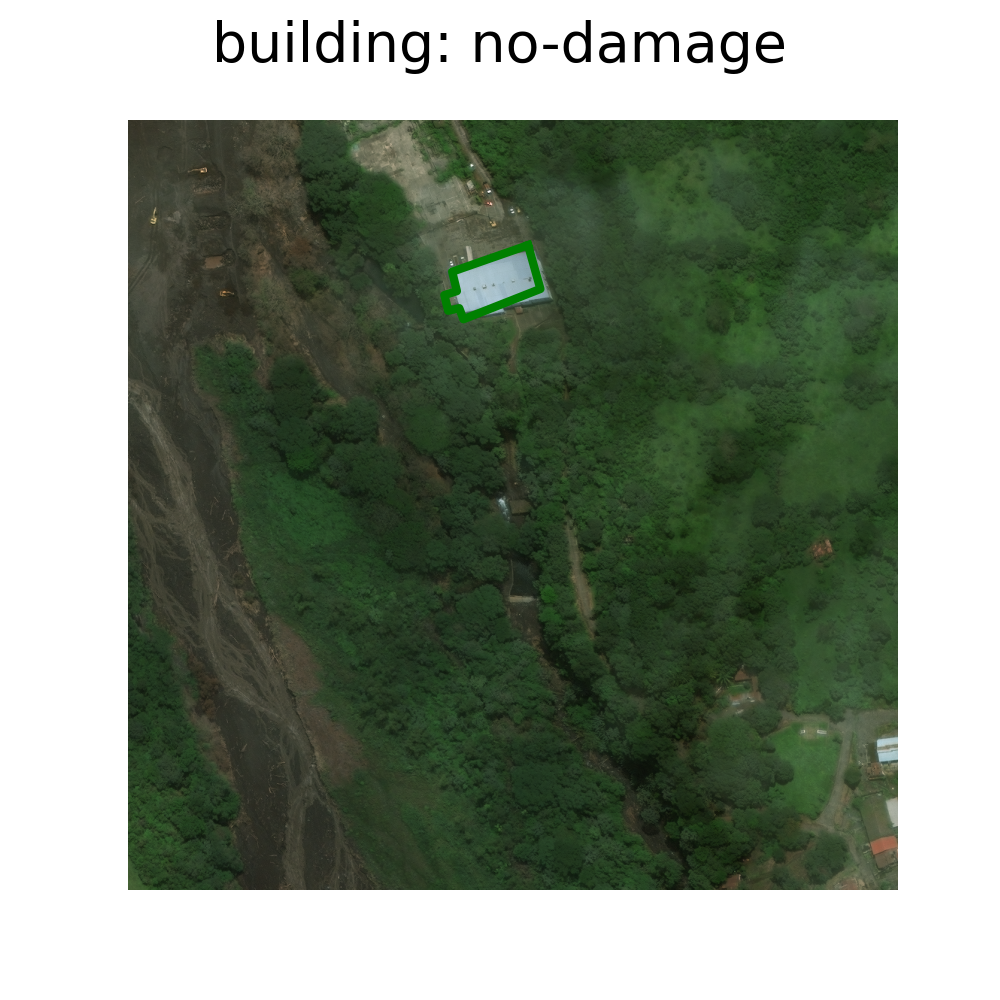
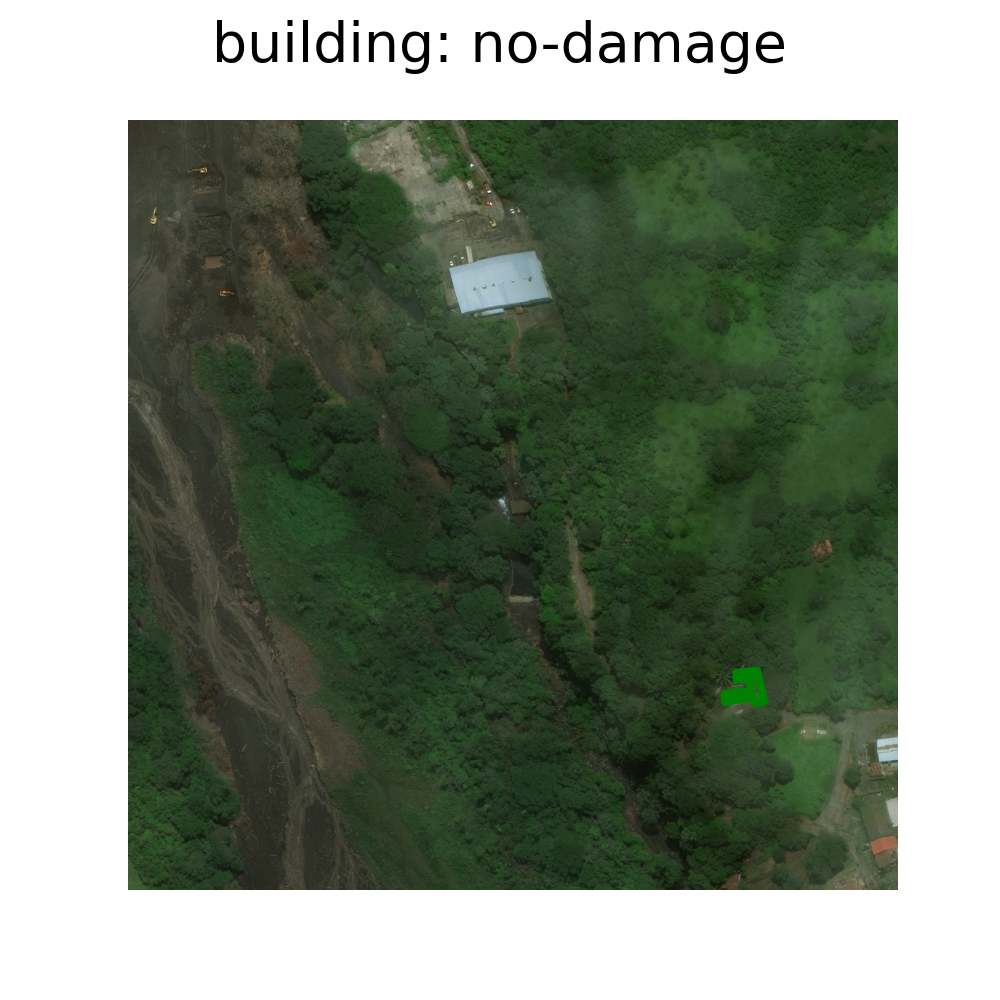
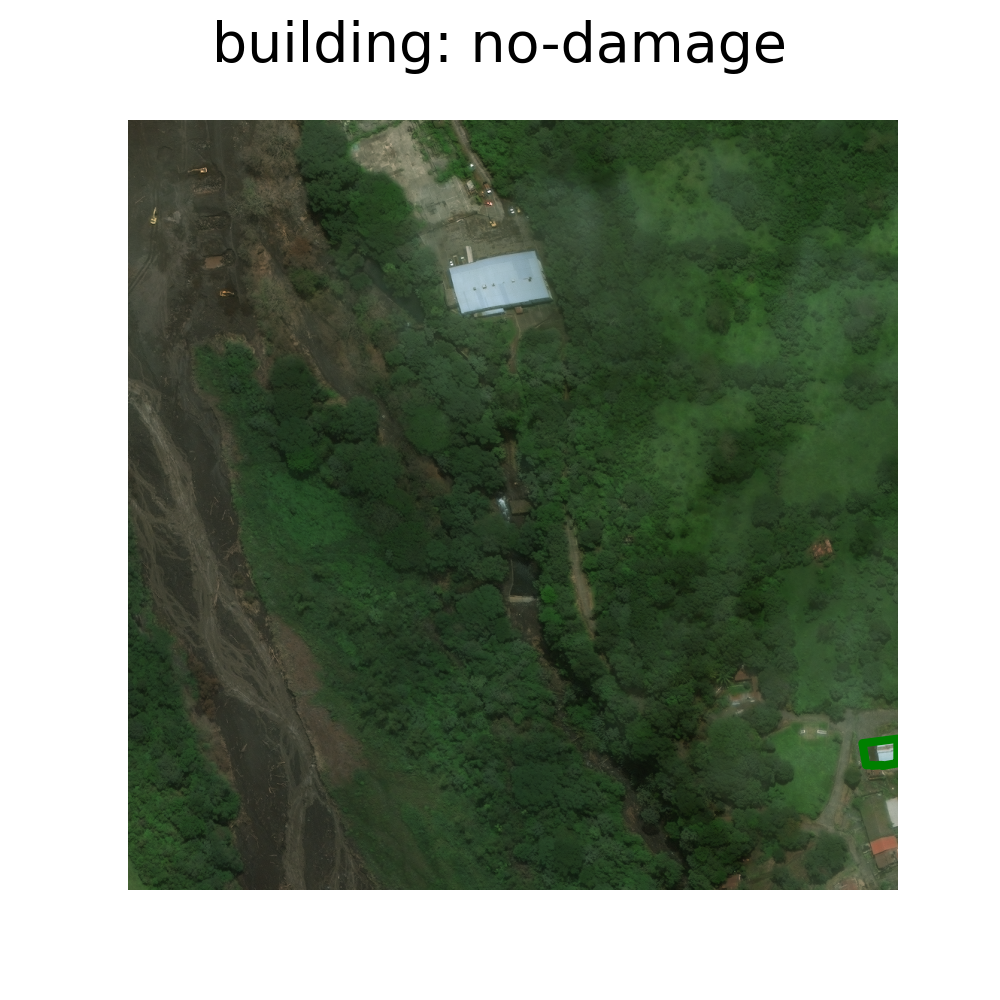
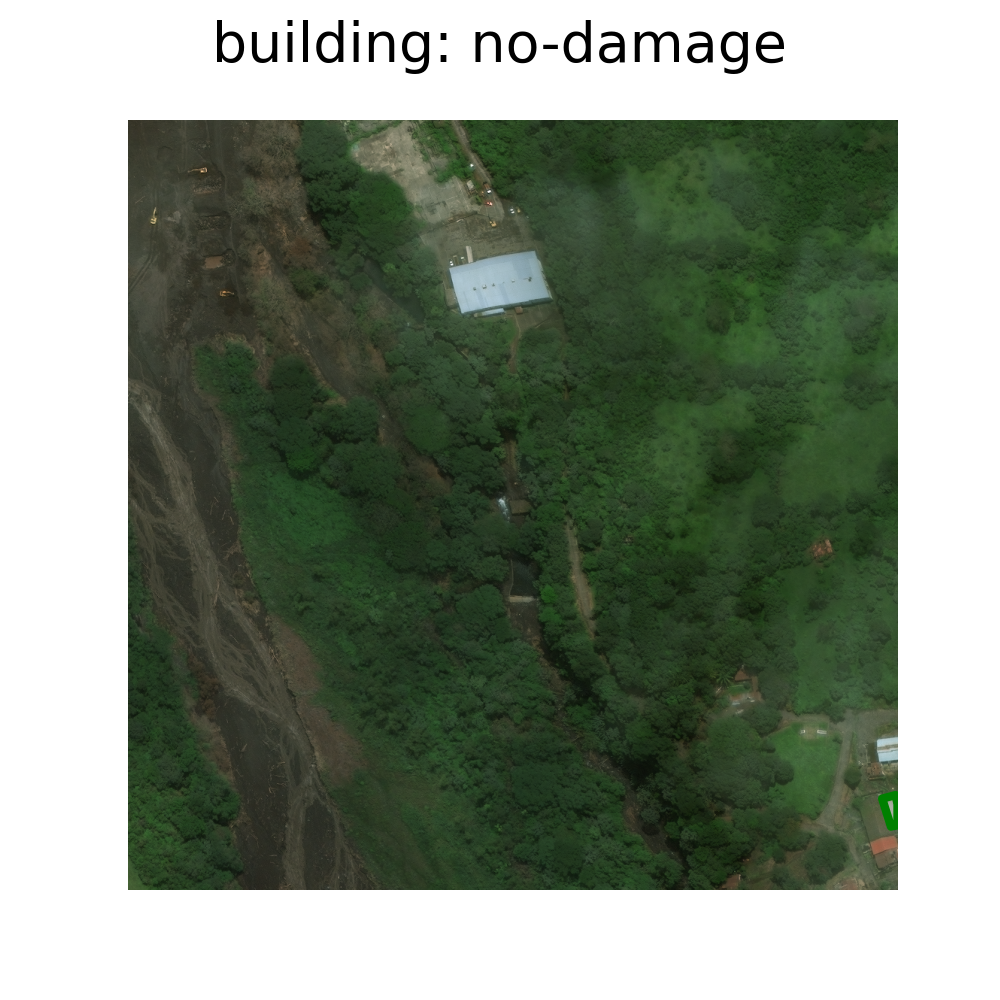
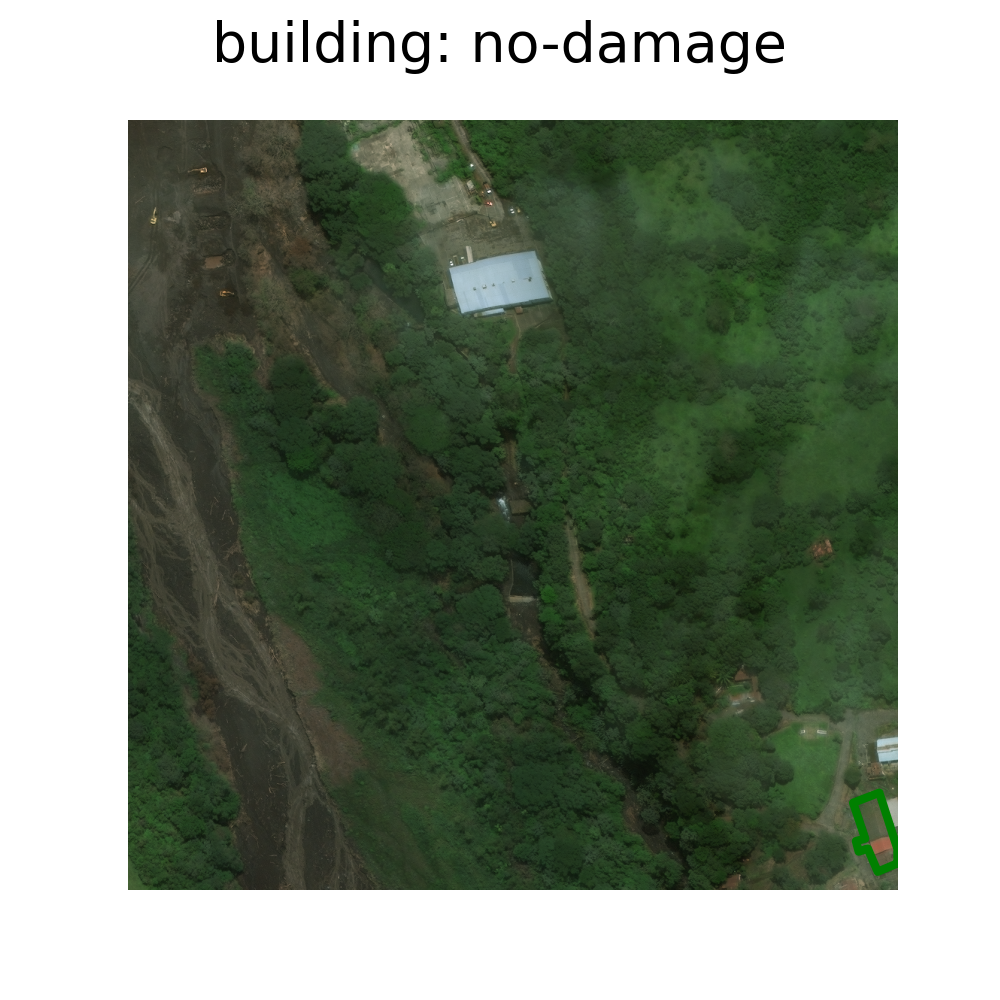
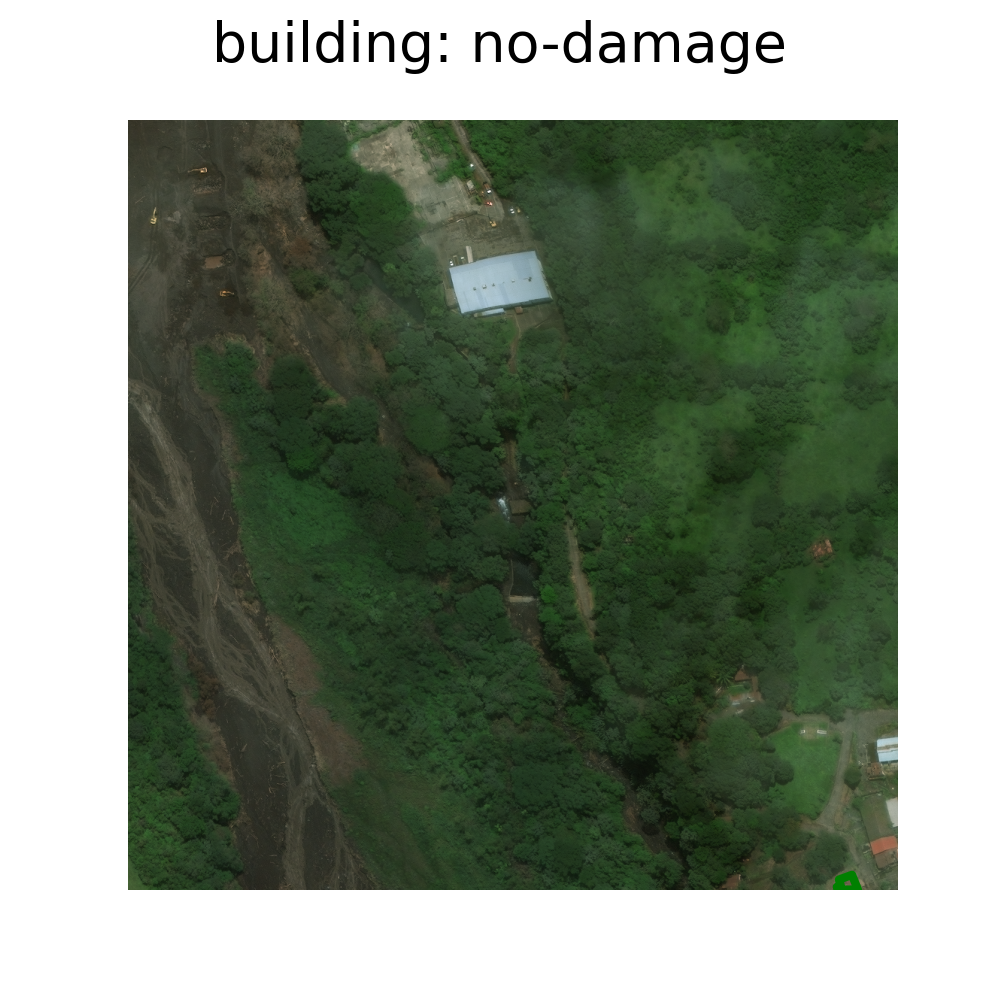
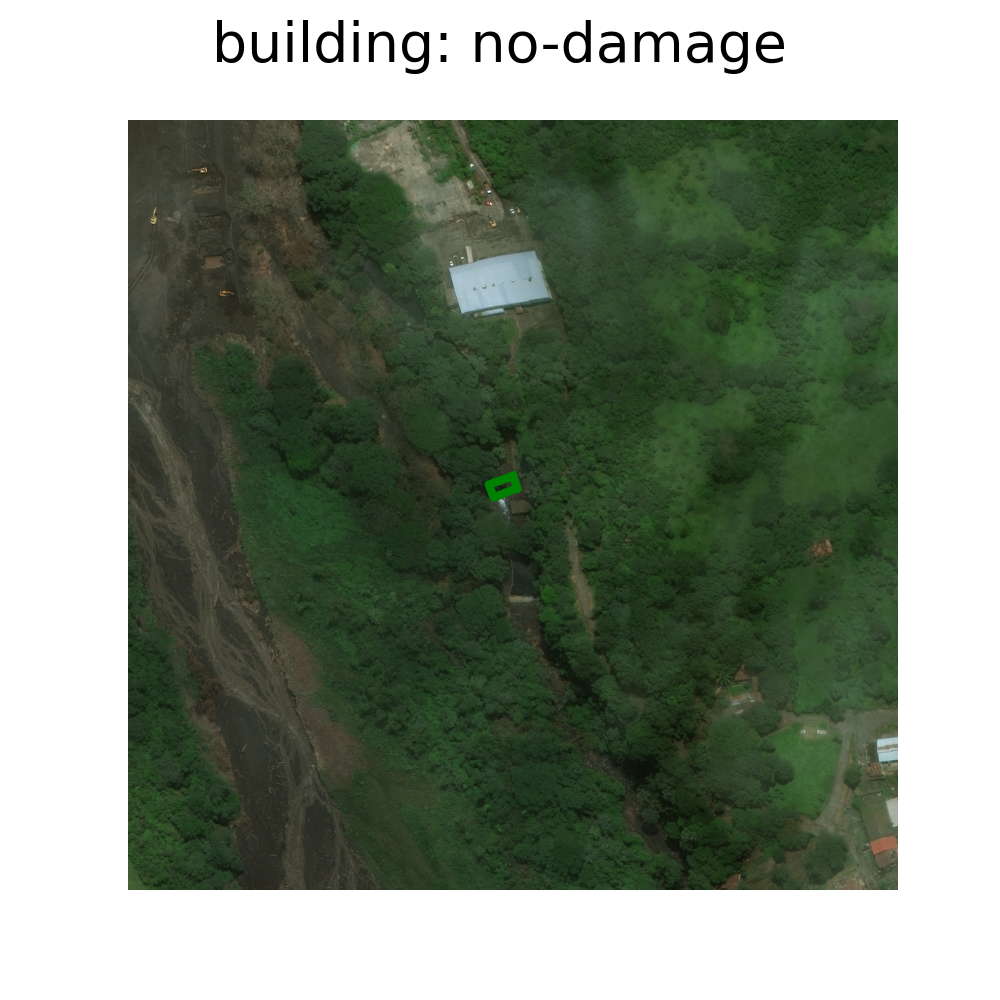
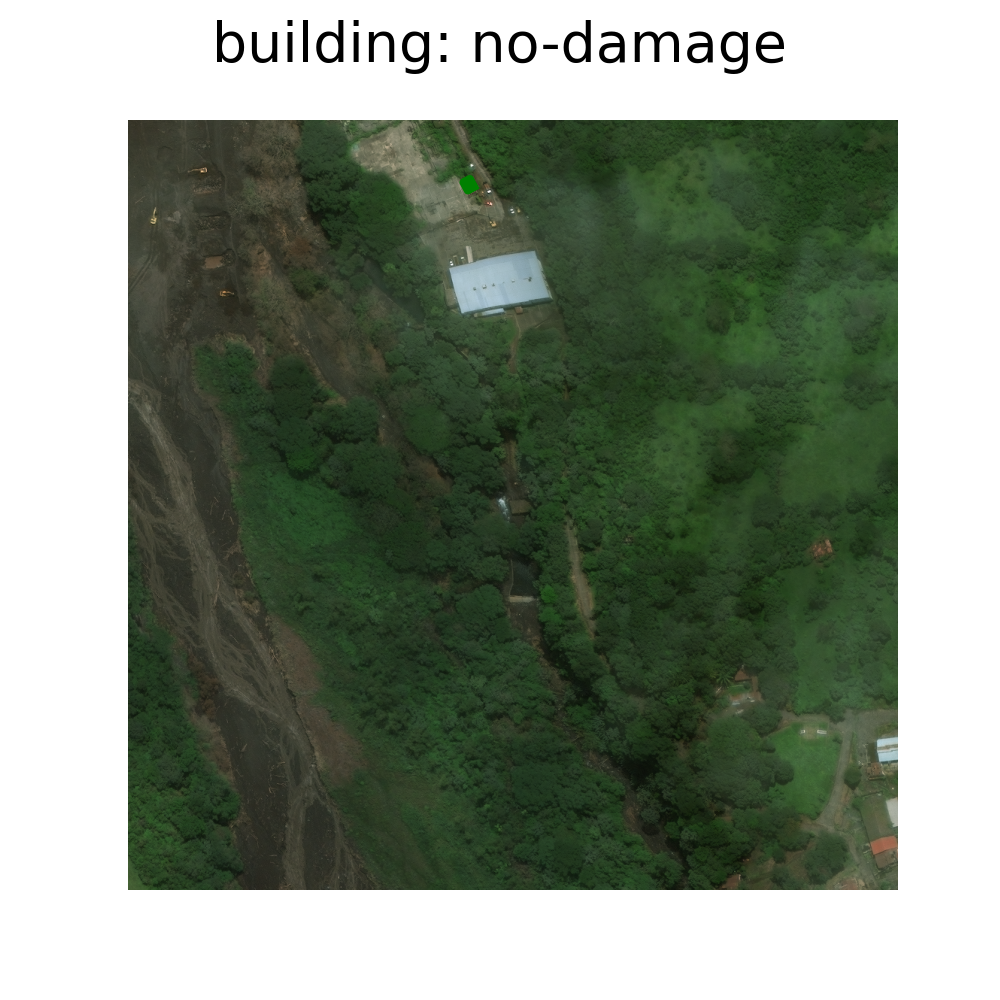
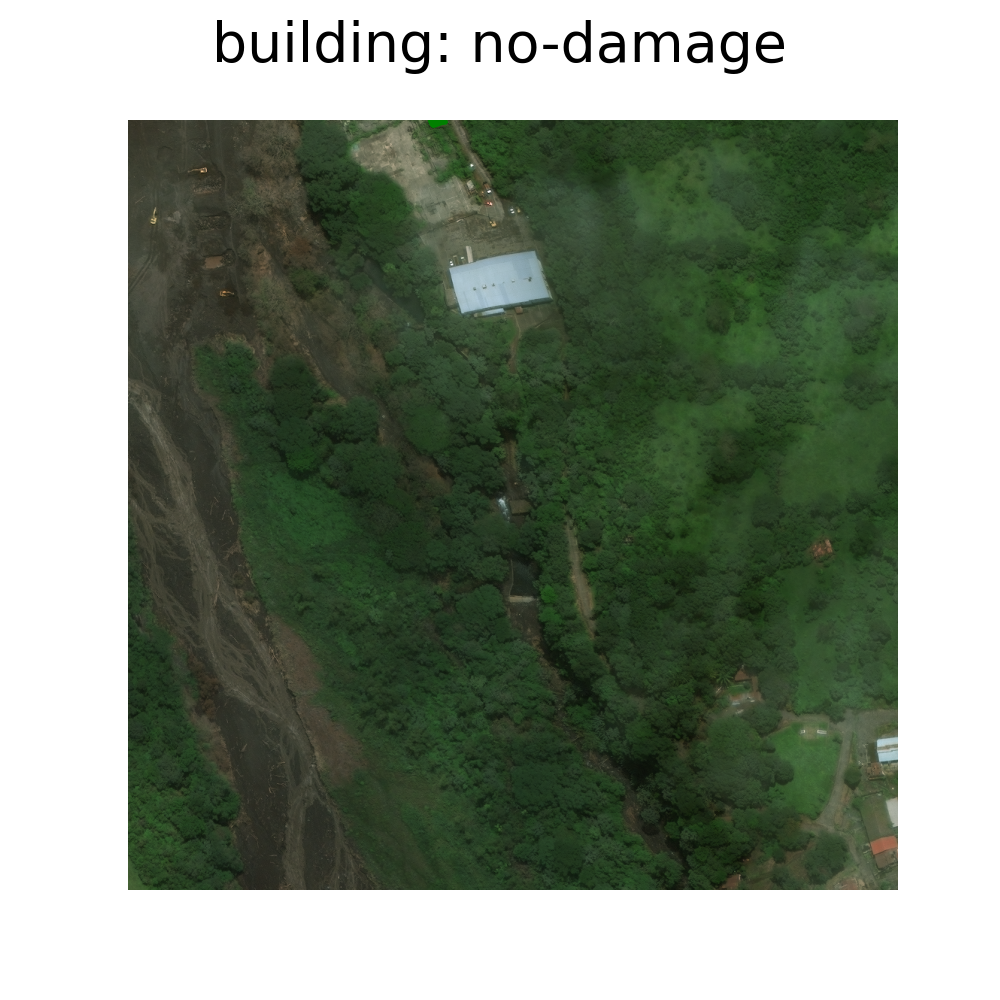
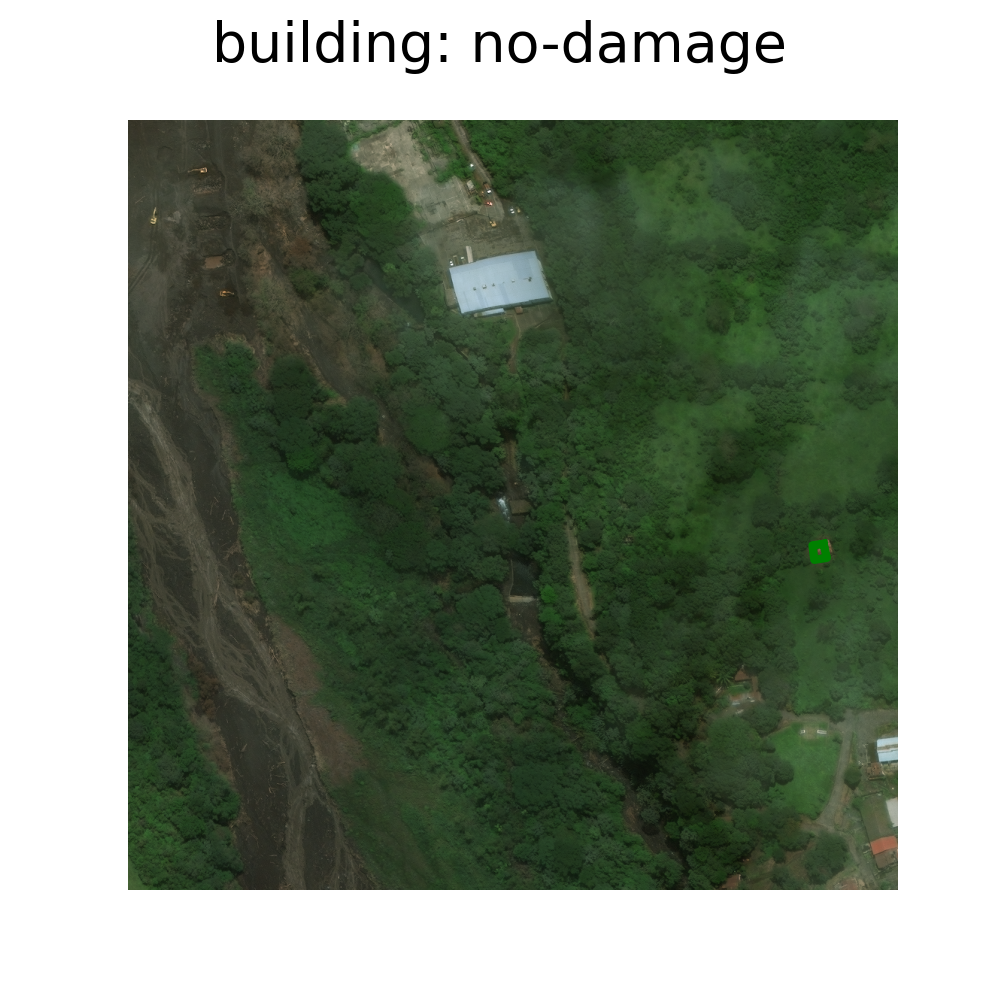

In [59]:
m = folium.Map()
for i, (label, label_img_draw_data) in enumerate(zip(labels['features']['lng_lat'], labels['features']['xy'])):
    points = []
    points_img = []
    subtype = label['properties'].get('subtype', "before event")
    if subtype=='no-damage':
        color='g'
    else:
        color='b'
    feature_type = label['properties']['feature_type']

    polygon_pts = label['wkt'][10:-2]
    for pt in polygon_pts.split(", "):
        points.append((float(pt.split(" ")[1]), float(pt.split(" ")[0])))
    folium.Polygon(points, color=color).add_to(m)

    polygon_pts = label_img_draw_data['wkt'][10:-2]
    for pt in polygon_pts.split(", "):
        points_img.append((float(pt.split(" ")[1]), float(pt.split(" ")[0])))
    polygon = shapely.geometry.Polygon(points_img)

    x,y = polygon.exterior.coords.xy
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(Image.open(path_to_image))
    ax.plot(y,x, color=color, linewidth=6)
    ax.axis('off')
    fig.suptitle(f"{feature_type}: {subtype}", fontsize=40)
    fig.savefig(f"tmp/tmp{i}.png")
    plt.close(fig)
    

    encoded = base64.b64encode(open(f"tmp/tmp{i}.png", 'rb').read()).decode('UTF-8')
    html = f'''
    <div><img src="data:image/png;base64,{encoded}" width="400" height="400"></div>
    '''


    popup = folium.Popup(html)
    folium.Marker(points[0], popup=popup).add_to(m)

m

In [14]:
def add_polygons_to_map(map, labels):
    for label in labels['features']['lng_lat']:
        points = []

        polygon_pts = label['wkt'][10:-2]

        for pt in polygon_pts.split(", "):
            points.append((float(pt.split(" ")[1]), float(pt.split(" ")[0])))

        folium.Polygon(points).add_to(map)
        subtype = label['properties'].get('subtype', "before event")
        feature_type = label['properties']['feature_type']
        html = f'''{feature_type}: {subtype}'''

        iframe = folium.IFrame(html,
                            width=200,
                            height=50)

        popup = folium.Popup(iframe,
                            max_width=200)

        folium.Marker(points[0],
                            popup=popup).add_to(map)

In [28]:
paths_to_labels = "train/labels/"

m = folium.Map(zoom_start=15)

labels_path = os.listdir(paths_to_labels)
labels_path.sort()

for label_path in labels_path[:10]:
    if "pre_disaster" in label_path:
        continue

    with open(paths_to_labels+label_path) as f:
        label = geojson.load(f)

    add_polygons_to_map(m, label)

m

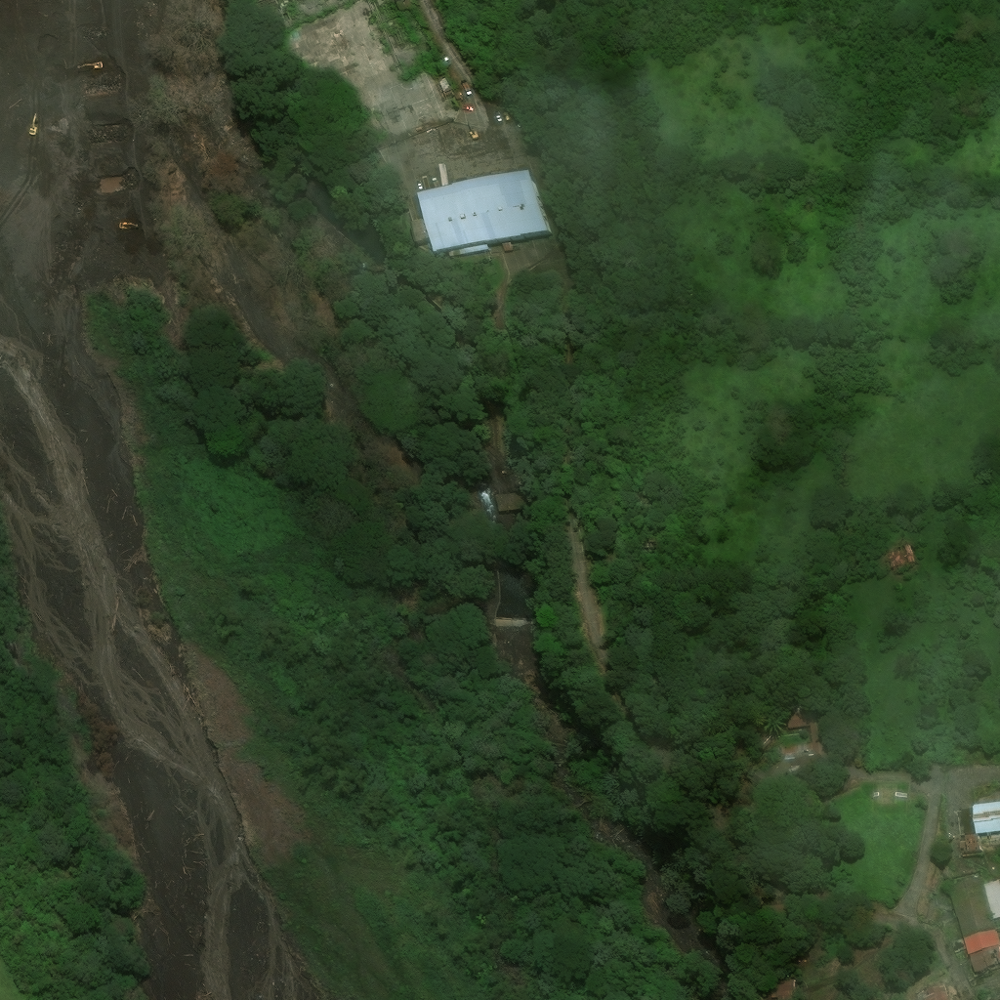

In [ ]:
image

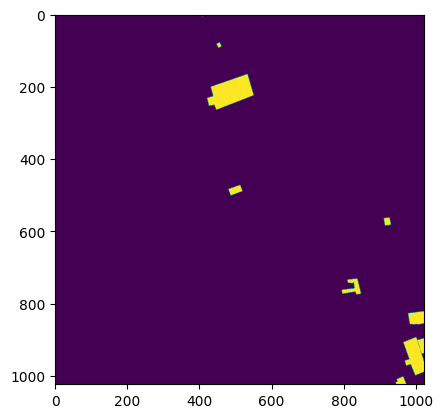

In [ ]:
plt.imshow(np.array(damage))